# Image Augmentation
Image augmentation synthetically creates training images by applying multiple processing transforms to a base image. Given that we may only have a small set of images, this technique helps creates enough data to begin training.

## Overview
With Amazon Rekognition Custom Labels, we can accelerate the process of training a ML model to identify logos in still frame images. In this notebook, we're using a logo as a base image and augmenting this image generate a dataset. This dataset will be used to train a ML model using Rekognition Custom Labels. This method differs from previous methods we've explored, namely the method of training a model using logos overlayed on a background image with various translations applied.



Let's start off loading an image to see what we're working with.

We'll need an S3 bucket to use for training and to store the tranied model artifacts. In this notebook, we require a custom bucket that exists so as to keep the naming clean.

In [15]:
import imageio, os, pathlib
import imgaug as ia
from imgaug import augmenters as iaa
import numpy as np
import matplotlib.pyplot as plt
from imgaug.augmentables.bbs import BoundingBox, BoundingBoxesOnImage
from os.path import join, isdir, isfile
from datetime import datetime
%matplotlib inline

In [11]:
bucket = 'broadcast-monitoring-assets' # custom bucket name.
# bucket = sess.default_bucket()
prefix = 'image-augmentation'
def gen_prefix():
    return os.path.join(prefix, datetime.utcnow().strftime('%Y%m%d-%H%M%S'))

For this notebook, we'll be using a set of logo images that has already been prepared. Run the following command to copy these images locally.

In [ ]:
!aws s3 sync 's3://' + bucket + '/images/station_logos' /tmp/data/station_logos

Original:


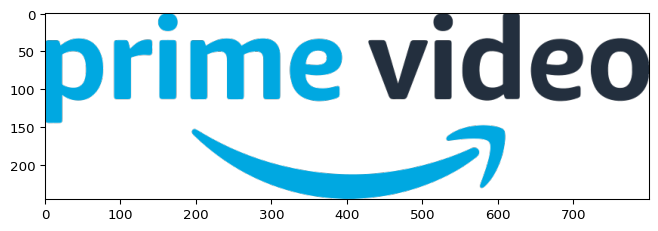

In [12]:
image = imageio.imread('/tmp/data/station_logos/amazon_prime_video/amazon_prime_video.png')

print('Original:')
ia.imshow(image)

### Augment the Image
We'll use [imgaug](https://imgaug.readthedocs.io/en/latest/index.html) to augment the image. This library supports a number of techniques to augment image data.

The following helper functions consolidate the repeated tasks to display results.

In [94]:
a = np.random.uniform(size=(2,3,4))

In [99]:
a.shape[2]

4

In [102]:
def draw_bbs(img, bbs, border=0, size=2, color=(0,255,0)):
    # create a pad augmenter
    pad = iaa.Pad(border)
    # using the pad augmenter, create both an updated image and shifted boun|ding box list
    padded_image, shifted_bbs = pad(image=img, bounding_boxes=bbs)
    
#     bbs_overlayed = shifted_bbs.draw_box_on_image(padded_image[:, :, :3], size=size, color=color)
    # draw boxes without labels
    bbs_overlayed = np.copy(padded_image[:, :,:3])
    for bb in shifted_bbs:
        bbs_overlayed = bb.draw_box_on_image(bbs_overlayed, size=size, color=color)
    
    # rebuild a RGBA image from the RGB bbs_overlayed and the alpha values
    # from the original image
    if padded_image.shape[2] == 4:
        with_alpha = np.dstack((bbs_overlayed, padded_image[:, :, 3]))
        # get all coords where the color is the bb color
        bbs_on = (bbs_overlayed == color).all(2)
        # update the alpha value where bb is to ensure it's visible
        with_alpha[bbs_on, 3] = 255
    else:
        with_alpha = bbs_overlayed
        
    return with_alpha

def create_img_bounding_boxes(img, label=None):
    return BoundingBoxesOnImage([BoundingBox(0,0, img.shape[1], img.shape[0], label=label)], shape=img.shape)

First, let's add a bounding box to the image and some additional padding to ensure the bounding box is visible.

Padded image w Bounding Boxe:


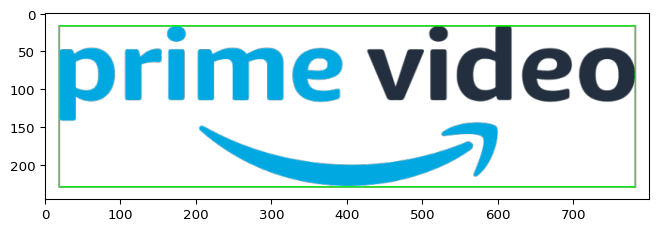

In [16]:
ia.seed(10)

bbs = create_img_bounding_boxes(image, 'prime_video')

print('Padded image w Bounding Boxe:')
ia.imshow(draw_bbs(image, bbs, 20))


Augmented:


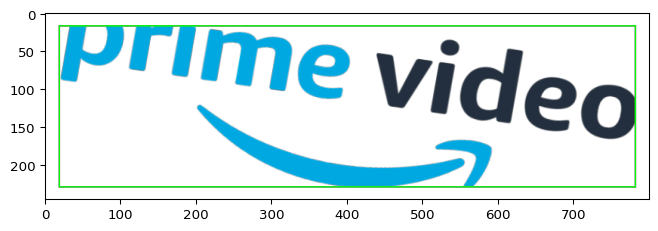

In [17]:
rotate = iaa.Affine(rotate=(-10,10))
image_aug, bbs_aug = rotate(image=image, bounding_boxes=bbs)
bbs_aug.clip_out_of_image_()
print('Augmented:')
ia.imshow(draw_bbs(image_aug, bbs_aug, 20))

### Augment a Batch of Images
Let's apply these same concepts to a batch of images.

In [18]:
def create_augmented_set(seq, img, bbs, count):
    images = [img] * count
    boxes = [bbs] * count
    images_aug, boxes_aug = seq(images=images, bounding_boxes=boxes)
    return images_aug, boxes_aug

Augmented batch:


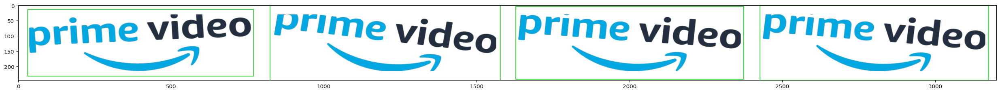

In [19]:
import numpy as np

images_aug, boxes_aug = create_augmented_set(rotate, image, bbs, 4)

print('Augmented batch:')
augmented = [draw_bbs(img, bbs, 40) for img, bbs in zip(images_aug, boxes_aug)]
ia.imshow(np.hstack(augmented))

### Setting image transparency
I've found there is no good way of setting the opacity/tranparency of an image.  The `set_alpha` function below addresses that by randomly setting the transparency of an image (using the alpha channel).  The `set_alpha_wrapper` makes the `set_alpha` function ussable by the img_aug library

In [146]:
DEFAULT_OPACITY_RANGE = (0.2, 0.6)
OPACITY_RANGE_STEP = 0.05

def set_alpha(img, sentinel_rgb=None, opacity=None, random_state=None):
    if random_state is None:
        random_state = np.random.default_rng()

    if len(opacity) == 1:
        opacity = opacity[0]
    else:
        mino, maxo = opacity
        opacity = random_state.choice(np.arange(mino, maxo+(0.99*OPACITY_RANGE_STEP), OPACITY_RANGE_STEP))

    # if not specified, take the color of the first pixel as the background color
    # to replace with full transparency
    if sentinel_rgb is None:
        sentinel_rgb = img[0, 0, :3]

    alpha_channel = int(opacity * 255)

    # Make into Numpy array of RGB and get dimensions
    RGB = img[:, :, :3]
    h, w = RGB.shape[:2]

    # Add an alpha channel, with specified opacity
    RGBA = np.dstack((RGB, np.zeros((h, w), dtype=np.uint8) + alpha_channel))

    # Make mask of black pixels - mask is True where image is black
    m_black = (RGBA[:, :, 0:3] == sentinel_rgb).all(2)
    m_alpha = (img[:, :, 3] == 0)

    # Make all pixels matched by mask into transparent ones
    RGBA[m_black] = (0, 0, 0, 0)
    RGBA[m_alpha] = (0, 0, 0, 0)

    # Convert Numnpy array back to PIL Image and save
    return RGBA


def set_alpha_wrapper(opacity_range=DEFAULT_OPACITY_RANGE):
    def inner(images, random_state, parents, hooks):
        results = [set_alpha(img, opacity=opacity_range, random_state=random_state) for img in images]
        return results
    return inner

In [111]:
import numpy as np

DEFAULT_OPACITY_RANGE = (0.2, 0.6)
OPACITY_RANGE_STEP = 0.05

def set_alpha(img, opacity=None, sentinel_rgb=None, random_state=None):
    if random_state is None:
        random_state = np.random.default_rng()
    
    if opacity is None:
        opacity_range = np.arange(DEFAULT_OPACITY_RANGE[0], DEFAULT_OPACITY_RANGE[1], OPACITY_RANGE_STEP)
        opacity = random_state.choice(opacity_range)
    
    # if not specified, take the color of the first pixel as the background color
    # to replace with full transparency
    if sentinel_rgb is None:
        sentinel_rgb = img[0, 0, :3]

    alpha_channel = int(opacity * 255)
#     print('opacity: ', opacity)

    # Make into Numpy array of RGB and get dimensions
    RGB = img[:, :, :3]
    h, w = RGB.shape[:2]

    # Add an alpha channel, with specified opacity
    RGBA = np.dstack((RGB, np.zeros((h, w), dtype=np.uint8) + alpha_channel))

    # Make mask of black pixels - mask is True where image is black
    m_black = (RGBA[:, :, 0:3] == sentinel_rgb).all(2)
    m_alpha = (img[:, :, 3] == 0)

    # Make all pixels matched by mask into transparent ones
    RGBA[m_black] = (0, 0, 0, 0)
    RGBA[m_alpha] = (0, 0, 0, 0)

    # Convert Numnpy array back to PIL Image and save
    return RGBA


def set_alpha_wrapper(images, random_state, parents, hooks):
    results = [set_alpha(img, random_state=random_state) for img in images]
    return results

### Applying multiple transforms
Using the `Sequential` augmenter, we can apply a pipeline of transforms to an image and the corresponding bounding boxes. This extends to bacthes of images which enables the creation of a random dataset

CPU times: user 1.05 s, sys: 7.93 ms, total: 1.06 s
Wall time: 704 ms
Augmented:


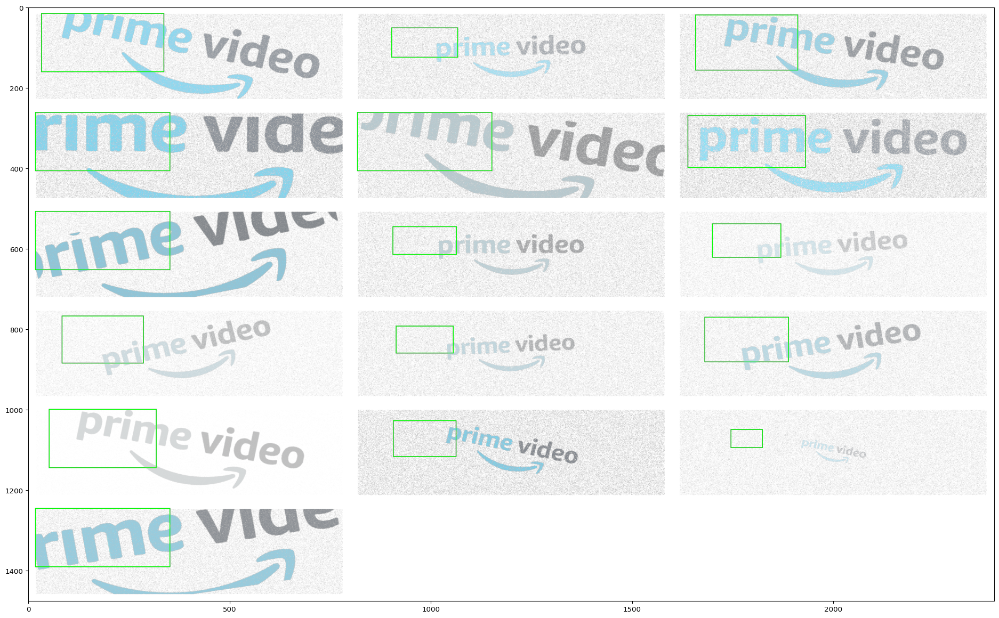

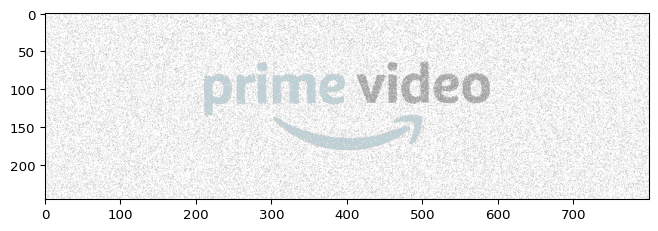

In [126]:
seq = iaa.Sequential([
    # randomly set the alpha channel
    iaa.Lambda(
        func_images=set_alpha_wrapper()
    ),
    # scale the image between 20% to 125% of its original size
    iaa.Affine(scale=(0.2, 1.3)),
    # rotate the image somewhere in the range of -10.0 - 10.0 deg
    iaa.Rotate((-15.0, 15.0)),
    # randomly apply the Grayscale augmenter to the RGB channels 
    iaa.WithChannels([0,1,2], iaa.Grayscale(alpha=(0.0, 1.0))),
    iaa.AdditiveGaussianNoise(scale=(0,60)),
])
image_count = 16
%time images_aug, boxes_aug = create_augmented_set(seq, image, bbs, image_count)
boxes_aug = [bb.clip_out_of_image_() for bb in boxes_aug]
augmented = [draw_bbs(img, bbs, 20) for img, bbs in zip(images_aug, boxes_aug)]
print('Augmented:')
cols = 3
rows = image_count // cols + (1 if image_count % cols > 0 else 0)
ia.imshow(ia.draw_grid(augmented, cols=cols, rows=rows))
ia.imshow(images_aug[7])

## Generating a ground truth manifest file
To train a Custom Labels model with our augmented images, we will generate an ground truth manifest file. Each entry in file will in the [JSON Line](http://jsonlines.org/) format. Expanded, the entry will take the following form([link to required attributes](https://docs.aws.amazon.com/rekognition/latest/customlabels-dg/cd-required-fields.html)):
```json
{
    "source-ref": "S3 bucket location", # Required
    "bounding-box": { # Required
        "image_size": [ # Required
            {
                "width": 500, # Required
                "height": 400, # Required
                "depth":3 # Required
            }
        ],
        "annotations": [ # Required
            {
                "class_id": 0, # Required
                "left": 111, # Required
                "top": 134, # Required
                "width": 61, # Required
                "height": 128 # Required
            }
        ]
    },
    "bounding-box-metadata": { # Required
        "objects": [ # Required
            {"confidence": 0.8}, # Required
        ],
        "class-map": { # Required
            "0": "dog", # Required
        }, 
        "type": "groundtruth/object-detection", # Required
        "human-annotated": "yes", # Required
        "creation-date": "2018-10-18T22:18:13.527256", # Required
    }
 }
```

### Buidling an output manifest line
The following functions enable us to write image and bounding box data in the output format described above. 

In [23]:
import os
from datetime import datetime

def build_annotation(label, pos, size):
    left, top = pos
    width, height = size
    return {
        'left': left,
        'top': top,
        'width': width,
        'height': height,
        'annotationType': 'bounding-box',
        'class_id': label
    }

def build_output_manifest_line(s3_bucket, s3_key, img, bounding_boxes, label_map):
    img_h, img_w, *_ = img.shape
    # create a reverse map of the class map to convert map[int]str -> map[str]int
    # to allow lookups of annotation value from label name
    r_label_map = {v: k for k, v in label_map.items()}
    def get_bb_info(bb):
        return {
        "pos": (bb.x1_int, bb.y1_int),
        "size": (bb.x2_int - bb.x1_int, bb.y2_int - bb.y1_int),
        "label": r_label_map.get(bb.label)
        }
    
    manifest_line = {
        'source-ref': f's3://{os.path.join(s3_bucket, s3_key)}',
        'bounding-box': {
            'annotations':
            [build_annotation(**get_bb_info(bb)) for bb in bounding_boxes],
            'image_size': [{
                "width": img_w,
                "height": img_h,
                "depth": 3
            }]
        },
        'bounding-box-metadata': {
            'class-map': {str(r_label_map[bb.label]): bb.label for bb in bounding_boxes},
            'human-annotated': "yes",
            'objects': [{'confidence': 1}] * len(bounding_boxes),
            'creation-date': f'{datetime.utcnow().isoformat()[:-3]}Z',
            'type': 'groundtruth/object-detection'
        }
    }
    return manifest_line

Let's test out these functions with an augmented image and bounding box. In addition to these elements, an S3 bucket and a key for the image file will be written.  The `label_map` is a mapping of integers to labels which would allow us to use multiple class bounding boxes in the same image.

In [24]:
build_output_manifest_line('test-bucket', 'test/key', image_aug, bbs_aug, {0: 'prime_video'})

{'source-ref': 's3://test-bucket/test/key',
 'bounding-box': {'annotations': [{'left': 0,
    'top': 0,
    'width': 800,
    'height': 246,
    'annotationType': 'bounding-box',
    'class_id': 0}],
  'image_size': [{'width': 800, 'height': 246, 'depth': 3}]},
 'bounding-box-metadata': {'class-map': {'0': 'prime_video'},
  'human-annotated': 'yes',
  'objects': [{'confidence': 1}],
  'creation-date': '2020-05-04T12:44:06.447Z',
  'type': 'groundtruth/object-detection'}}

## Generator Pipelines all the way down
Now that we have a way to augment image, transform the bounding boxes, and create an line for a manifest file, we can put all of the steps together. A generator pipeline allows us to break apart the steps into smaller parts while processing a list. In this case, a representation of each logo will be created as a dict and each fucntion will `yield` elements of the list for additional processing.


### Write the manifest file to S3

Using images and bounding boxes from a source, `generate_manifest_file_to_s3` will return a function that builds on `build_output_manifest_line` to combine the results into a file and upload it to s3.
    

In [25]:
import json
import os
from io import StringIO
import boto3

s3 = boto3.client('s3')

def generate_manifest_file_to_s3(bucket, prefix, label_map, manifest_file='output.manifest'):
    '''
    Higher order function that capture base information to write output manifest
    data to an manifest file and upload it to s3
    '''
    def build_helper(name, img, bbs, label, **kwargs):
        key = os.path.join(prefix, name)
        return build_output_manifest_line(bucket, key, img, bbs, label_map)
    
    def write_manifest_data_to_s3(data):
        print(f'Writing data to a manifest: {manifest_file}')
        with StringIO() as buf:
            for el in data:
                line = build_helper(**el)
                buf.write(json.dumps(line) + '\n')
                yield el
            buf.seek(0)
            # write to s3
            key = os.path.join(prefix, manifest_file)
            s3.put_object(Bucket=bucket, Key=key, Body=buf.read())
            print(f'Uploading manifest file to s3://{bucket}/{key}')
    return write_manifest_data_to_s3

### Write images to S3
Again, making use of the generated source data, here we'll be writing the augmented image to an in memory file and upload the image to s3.

In [26]:
from io import BytesIO

def store_image_to_s3(bucket, prefix):
    def write_image_data_to_s3(data):
        for el in data:
            with BytesIO() as buf:
                name, img = [el[k] for k in ['name', 'img']]
                imageio.imwrite(buf, img, format='PNG-PIL')
                buf.seek(0)
                s3.upload_fileobj(buf, bucket, os.path.join(prefix, name))
            
            yield el
    return write_image_data_to_s3

### Consolidate logging and progress outputs

In [27]:
def progress(data):
    output_it, output_count = 0, 10
    yield f'Starting processing'
    for i, el in enumerate(data, 1):
        if i % output_count == 0:
            yield f'\t{i} image(s) processed'
            output_it += 1
        if output_it == 10:
            output_count *= 10
            output_it = 0
    yield f'Image upload complete! Total: {i}'

### Testing out the pipeline

In [ ]:
from datetime import datetime
label_map = {'0': 'prime_video'}

test_prefix = gen_prefix()
generate_manifest = generate_manifest_file_to_s3(bucket, test_prefix, label_map)
upload_to_s3 = store_image_to_s3(bucket, test_prefix)

data = {'label':'prime_video', 'name': 'prime-video-1.png', 'img':image, 'bbs': bbs}
# something([data, data, data, data])
pipeline = progress(upload_to_s3(generate_manifest([data, data, data, data])))
res = list(pipeline)

## Putting it all together

In [28]:
def get_file_paths(src_dir):
    return [join(src_dir, f) for f in os.listdir(src_dir) if isfile(join(src_dir, f))]

def get_logos(base_dir, name_filter=None):
    logo_names = [fn for fn in os.listdir(base_dir) if isdir(join(base_dir, fn))]

    if name_filter is not None:
        logo_names = set(name_filter) & set(logo_names)

    for name in logo_names:
        logo_base_path = join(base_dir, name)
        for path in get_file_paths(logo_base_path):
            yield name, path

def generate_augmented_logos(logos, count):
    for label, path in logos:
        base_name, ext = os.path.splitext(os.path.basename(path))
        img = imageio.imread(path)
        bbs = create_img_bounding_boxes(img, label=label)
        print(f'\tcreating augmented images for {path}')
        images_aug, boxes_aug = create_augmented_set(seq, img, bbs, count)
        print(f'\taugmented images created')
        for i, (img, bbs) in enumerate(zip(images_aug, boxes_aug)):
            yield {
                'label': label,
                'name': f'{base_name}-{i}{ext}',
                'img': img,
                'bbs': bbs
            }


In [29]:
def build_test_image_set(base_dir, count, logo_filter=None):
    logos = list(get_logos(pathlib.Path(base_dir).resolve(), logo_filter))
    label_map = dict(enumerate({label for label, _ in logos}))

    test_prefix = gen_prefix()
    generate_manifest = generate_manifest_file_to_s3(bucket, test_prefix, label_map)
    upload_to_s3 = store_image_to_s3(bucket, test_prefix)

    data = generate_augmented_logos(logos, count)
    pipeline = upload_to_s3(generate_manifest(data))
    for res in progress(pipeline):
        print(res)


In [ ]:
build_test_image_set('/tmp/data/station_logos', 5, ['amazon_prime_video', 'channel_a', 'good_logo', 'bad_logo'])

## Exploring overlaying an augmented logo
We've got the basics taken care of for generating training data, but for testing of that training data, we want to know how the model performs agains logos overlayed on various backgrounds. Here we'll use another log for testing and see what the process looks like.

Result:


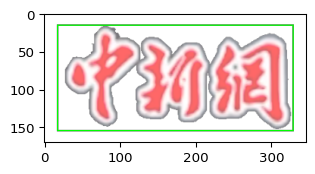

In [150]:
test_img = imageio.imread('../data/station_logos/cns-network/cns-network-character.png')
bbs = create_img_bounding_boxes(test_img, 'prime_video')

aug = iaa.Sequential([iaa.Lambda(func_images=set_alpha_wrapper())])
res_img, res_bbs = aug(images=[test_img], bounding_boxes=[bbs])
print('Result:')
ia.imshow(draw_bbs(res_img[0], res_bbs[0], border=20))

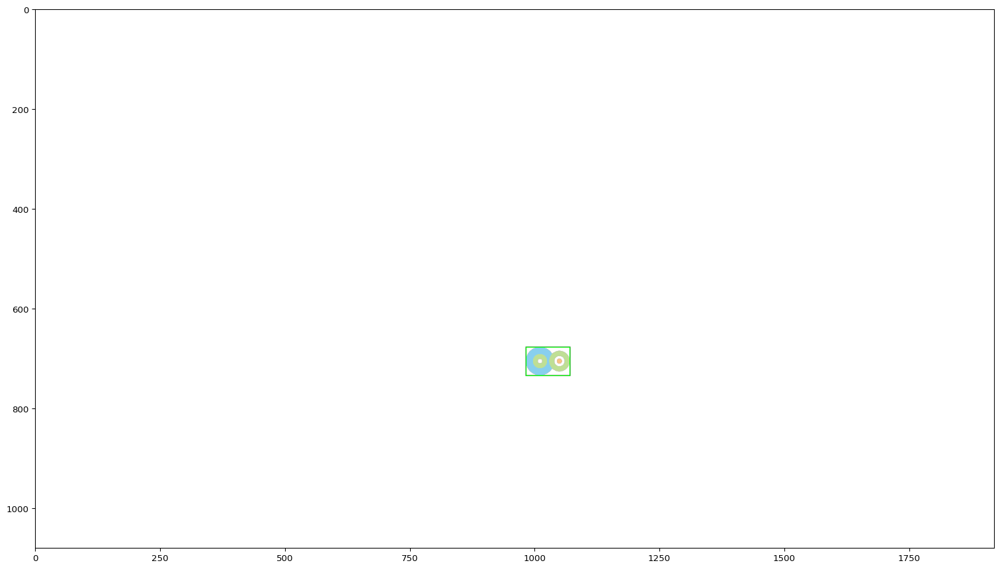

In [53]:
overlay_process = iaa.Sequential([
    iaa.Lambda(func_images=set_alpha_wrapper()),
    iaa.Resize({"shorter-side": 256, "longer-side": "keep-aspect-ratio"}),
    iaa.Affine(scale=(0.1, 0.3)),
    iaa.PadToFixedSize(height=1080, width=1920)
])
res, res_bbs = overlay_process(image=test_img, bounding_boxes=bbs)
ia.imshow(draw_bbs(res, res_bbs, 0))

In [47]:
from PIL import Image
from PIL import ImageOps as iops

def fit_image(img, size):
    return iops.fit(Image.fromarray(img), size)

In [48]:
img_paths = get_file_paths(pathlib.Path('../data/backgrounds/').resolve())
bg_imgs = [imageio.imread(img) for img in img_paths]
fit_images = [fit_image(img, (1920, 1080)) for img in bg_imgs]

In [ ]:
fit_images[0].alpha_compo

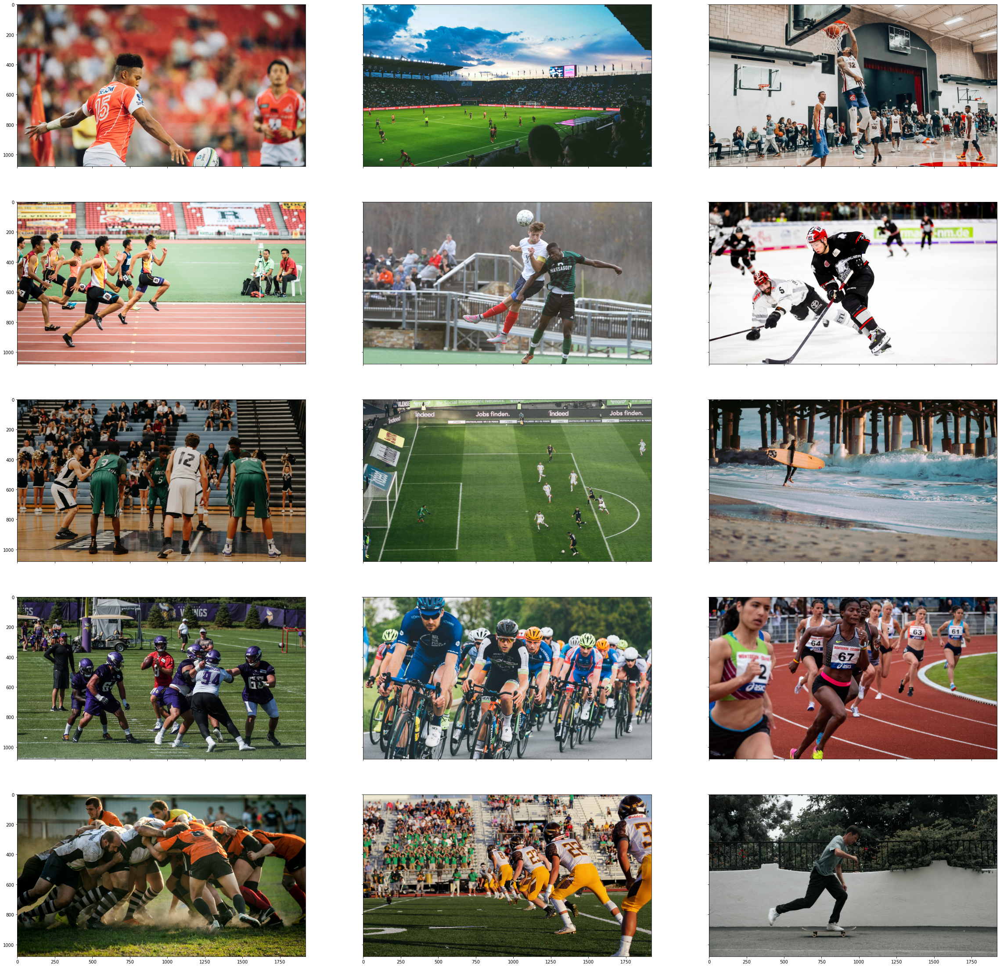

In [49]:
import matplotlib.pyplot as plt
nrows, ncols = 5, 3
_, axs = plt.subplots(nrows, ncols, sharex=True, sharey=True, figsize=(40,40))

for ax, img in zip(axs.ravel(), fit_images):
        ax.imshow(img)
        ax.grid(False)
plt.show()

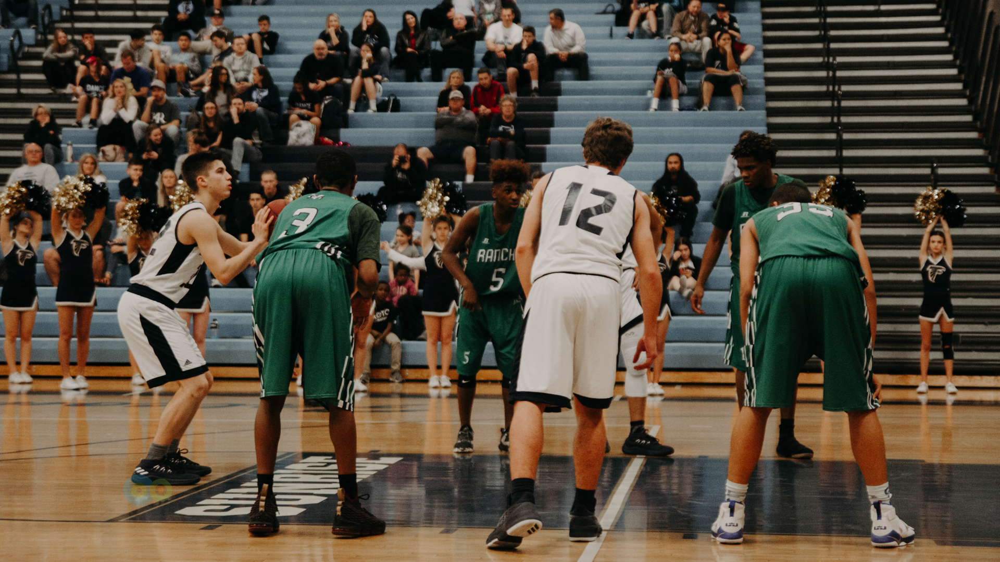

In [51]:
import random
new_bg = random.choice(fit_images).copy()
logo = overlay_process(image=test_img)
logo_img = Image.fromarray(logo)
new_bg.paste(logo_img, (0,0), logo_img)
new_bg

In [88]:
def _overlay_logo_bg(logo, bg, size):
    logo_img = Image.fromarray(logo)
    bg_img = iops.fit(Image.fromarray(bg), size)
    bg_img.paste(logo_img, (0,0), logo_img)
    return bg_img


def overlay_logo_bg(logo_path, logo_name, bg_path, size, scale=(0.2, 0.3)):
    '''Overlay a logo on a background image
    :param logo_path: path of the logo to overlay
    :param logo_name: name of the logo to overlay
    :param bg_path: path to the background logo to overlay
    :param size: tuple (w,h) with the size of the output image 
    :param scale: range of values to scale the logo
    '''
    logo = imageio.imread(logo_path)
    bbs = create_img_bounding_boxes(logo, logo_name)
    bg = imageio.imread(bg_path)
    
    overlay_aug = iaa.Sequential([
        # apply lambda to change the opacit
        iaa.Lambda(func_images=set_alpha_wrapper()),
        # convert the image to a set size
        iaa.Resize({"shorter-side": 256, "longer-side": "keep-aspect-ratio"}),
        # resize within a range
        iaa.Affine(scale=scale),
        # pad to a fixed size
        iaa.PadToFixedSize(width=size[0], height=size[1])
    ])
    
    res_img, res_bbs = overlay_aug(image=logo, bounding_boxes=bbs)
    
    overlayed_img = _overlay_logo_bg(res_img, bg, size)
    return np.array(overlayed_img), res_bbs
    

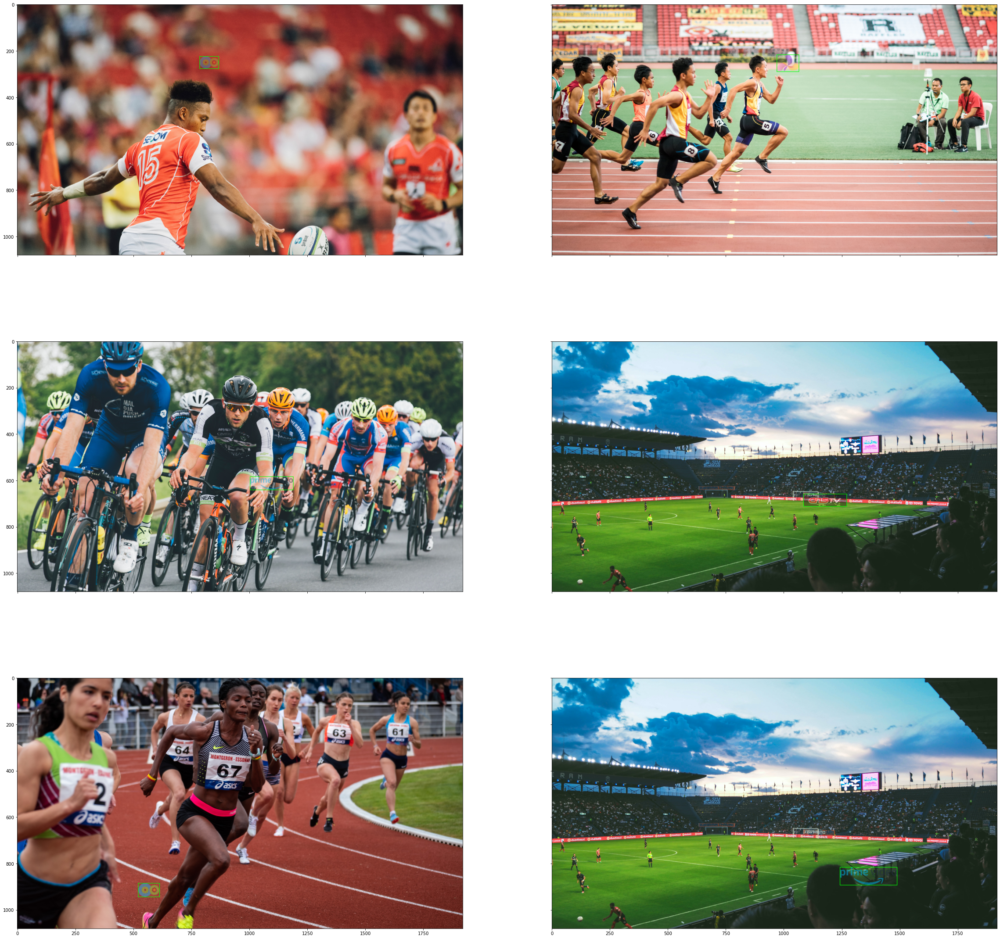

TypeError: imsave() missing 1 required positional argument: 'arr'

In [104]:
k = 6
logos = random.choices(list(get_logos('../data/station_logos/')), k=k)
bg_paths = random.choices(img_paths, k=k)
    
fig, axs = plt.subplots(3, 2, sharey='row', sharex=True, figsize=(40,40))
    
for ax, logo_data, bg_path in zip(axs.ravel(), logos, bg_paths):
    logo_name, logo_path = logo_data
    res_img, res_bbs = overlay_logo_bg(logo_path, logo_name, bg_path, (1920, 1080))
    
    ax.imshow(draw_bbs(res_img, res_bbs))
    ax.grid(False)
    
plt.show()
    